In [308]:
import tweepy
from kafka import KafkaProducer, KafkaClient
import kafka
from kafka import KafkaProducer
import pandas as pd
from textblob import TextBlob
from textblob_fr import PatternTagger, PatternAnalyzer
import numpy as np
import datetime




consumer_key = "LiH48yEm4kL0prw29JCoodvjl"
consumer_secret = "pbFRjG9zl7OHV2sPHkFMGMhDp8Xj2ZZXjt2nPIrz66FovknG7H"
access_token = "1381909649092440072-YjNu4OHJ5DcLutWrH3Y1kOgh6Nc4Zi"
access_token_secret = "Jv86RWYZBaRMGI9fQiqAD4vRj761BiKj2c8isJ8RAFoLO"
tweets=[]
tweets_text=[]
nbr_tweets=0
nbr_tweets_negatif=0
nbr_tweets_positif=0
nbr_tweets_neutre=0
negative_list_text=[]
positif_list_text=[]
neutre_list_text=[]


# Subclass Stream to print IDs of Tweets received
class IDPrinter(tweepy.Stream):

    def on_status(self, status):
        tweet_info={}
        producer.send("test-topic", status.text.encode('utf-8'))
 
        print(status.created_at)
        print(status.text)
        print(status.lang )
        print(status.id) 
        print(status.source)
        print("/n                 ************************************************")
        
        tweet_info['created_at']=status.created_at
        tweet_info['text']=status.text  
        tweet_info['lang']=status.lang 
        tweet_info['ID']=status.id
        tweet_info['source']=status.source
        
        tweets.append(tweet_info)
        
        tweets_text.append(status.text)
       
        
        return True

# Initialize instance of the subclass
producer = KafkaProducer(bootstrap_servers='localhost:9092')
printer = IDPrinter(
  consumer_key, consumer_secret,
  access_token, access_token_secret
)

# Filter realtime Tweets by keyword
printer.filter(track=["liverpool"])

2022-05-29 01:18:34+00:00
Let us be clear. In 3 finals Liverpool played, 330 minutes of football, overrated Jurgen Klopp has led his team to… https://t.co/zJkBHRNqej
en
1530720220137984000
Twitter for Android
/n                 ************************************************
2022-05-29 01:18:34+00:00
Liverpool campeón!!! Ya estamos en stream para celebrar https://t.co/BeLLsj1Nnw #twitch #LeagueOfLegends #MSI2022
es
1530720220800745472
Twitter for iPhone
/n                 ************************************************
2022-05-29 01:18:34+00:00
RT @kennethdalglish: The Liverpool fans are special. The way they were treated by authorities was an absolute joke. Nobody should ever be a…
en
1530720221899673600
Twitter for iPhone
/n                 ************************************************
2022-05-29 01:18:34+00:00
RT @Chunkz: Real Madrid with the best Champions League win ever. They beat PSG, Chelsea, City and Liverpool. Wow.
en
1530720221807489024
Twitter for Android
/n           

KeyboardInterrupt: 

In [347]:
import datetime

In [309]:
tweets

[{'created_at': datetime.datetime(2022, 5, 29, 1, 18, 34, tzinfo=datetime.timezone.utc),
  'text': 'Let us be clear. In 3 finals Liverpool played, 330 minutes of football, overrated Jurgen Klopp has led his team to… https://t.co/zJkBHRNqej',
  'lang': 'en',
  'ID': 1530720220137984000,
  'source': 'Twitter for Android'},
 {'created_at': datetime.datetime(2022, 5, 29, 1, 18, 34, tzinfo=datetime.timezone.utc),
  'text': 'Liverpool campeón!!! Ya estamos en stream para celebrar https://t.co/BeLLsj1Nnw #twitch #LeagueOfLegends #MSI2022',
  'lang': 'es',
  'ID': 1530720220800745472,
  'source': 'Twitter for iPhone'},
 {'created_at': datetime.datetime(2022, 5, 29, 1, 18, 34, tzinfo=datetime.timezone.utc),
  'text': 'RT @kennethdalglish: The Liverpool fans are special. The way they were treated by authorities was an absolute joke. Nobody should ever be a…',
  'lang': 'en',
  'ID': 1530720221899673600,
  'source': 'Twitter for iPhone'},
 {'created_at': datetime.datetime(2022, 5, 29, 1, 18, 34, 

In [327]:
df_tweets3=pd.DataFrame(tweets,columns=['created_at','text','lang','ID','source'] )


In [339]:
polarity = []
for tweety in  tweets_text:
   
    polarity.append(TextBlob(tweety,pos_tagger=PatternTagger(),analyzer=PatternAnalyzer()).sentiment[0])
    score=TextBlob(tweety,pos_tagger=PatternTagger(),analyzer=PatternAnalyzer()).sentiment[0]
    nbr_tweets+= 1
    if score <0:
        negative_list_text.append(tweets_text)
        nbr_tweets_negatif += 1
    elif score >0:
        positif_list_text.append(tweets_text)
        nbr_tweets_positif += 1
    elif  score ==0:
        neutre_list_text.append(tweets_text)
        nbr_tweets_neutre += 1


In [340]:
df_polarity=pd.DataFrame(polarity,columns=['Sentiment'] )


In [313]:
df_polarity

,Sentiment
0,0.0
1,0.0
2,0.5
3,0.0
4,0.0
...,...
1986,0.0
1987,0.5
1988,0.0
1989,0.0


In [314]:
polarity

[0.0,
 0.0,
 0.5,
 0.0,
 0.0,
 0.5,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.25,
 -0.7,
 -0.5,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 -0.5,
 0.0,
 0.0,
 -0.5,
 0.0,
 -0.45,
 0.0,
 -0.5,
 0.0,
 -0.5,
 0.0,
 0.0,
 -0.5,
 0.2,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.2,
 0.0,
 0.0,
 0.0,
 0.0,
 0.375,
 0.5,
 0.06666666666666667,
 0.0,
 0.2,
 0.0,
 -0.4333333333333333,
 -0.1,
 0.0,
 0.2,
 0.0,
 0.0,
 0.0,
 -0.5,
 0.0,
 0.0,
 0.5,
 0.0,
 0.0,
 0.0,
 0.5,
 0.0,
 0.0,
 0.5,
 0.0,
 -0.5,
 0.0,
 0.0,
 0.0,
 -0.75,
 -0.15000000000000002,
 0.2,
 0.0,
 0.0,
 0.5,
 0.0,
 0.0,
 0.0,
 0.5,
 0.0,
 0.0,
 0.0,
 0.0,
 0.1,
 -0.45,
 0.3,
 0.0,
 0.5,
 -0.5,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.1,
 0.0,
 -0.5,
 0.0,
 0.0,
 0.0,
 0.0,
 -0.5,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.5,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 -0.15,
 0.0,
 0.0,
 0.0,
 0.53,
 0.0,
 0.5,
 0.0,
 0.0,
 0.0,
 -0.15,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 -0.5,
 0.0,
 0.0,
 -0.25,
 0.0,
 0.0,
 0.

In [315]:
df_tweets3


,created_at,text,lang,ID,source
0,2022-05-29 01:18:34+00:00,"Let us be clear. In 3 finals Liverpool played,...",en,1530720220137984000,Twitter for Android
1,2022-05-29 01:18:34+00:00,Liverpool campeón!!! Ya estamos en stream para...,es,1530720220800745472,Twitter for iPhone
2,2022-05-29 01:18:34+00:00,RT @kennethdalglish: The Liverpool fans are sp...,en,1530720221899673600,Twitter for iPhone
3,2022-05-29 01:18:34+00:00,RT @Chunkz: Real Madrid with the best Champion...,en,1530720221807489024,Twitter for Android
4,2022-05-29 01:18:35+00:00,RT @Volve10Riquelme: 24 remates del Liverpool ...,es,1530720223321477123,Twitter for iPhone
...,...,...,...,...,...
1986,2022-05-29 01:22:32+00:00,"RT @_KKWWFC: “Bell that coach place again, la”...",en,1530721217254236160,Twitter for iPhone
1987,2022-05-29 01:22:32+00:00,RT @kennethdalglish: The Liverpool fans are sp...,en,1530721217258442753,Twitter for iPhone
1988,2022-05-29 01:22:32+00:00,How did this guy get the idea that liverpool w...,en,1530721217166163970,Twitter for Android
1989,2022-05-29 01:22:32+00:00,RT @chrismd10: Tell me you’ve kicked a ball 4 ...,en,1530721217795092481,Twitter for Android


In [316]:
x_=df_tweets3.copy()


In [317]:
pd.concat([x_, df_polarity],axis=1)

,created_at,text,lang,ID,source,Sentiment
0,2022-05-29 01:18:34+00:00,"Let us be clear. In 3 finals Liverpool played,...",en,1530720220137984000,Twitter for Android,0.0
1,2022-05-29 01:18:34+00:00,Liverpool campeón!!! Ya estamos en stream para...,es,1530720220800745472,Twitter for iPhone,0.0
2,2022-05-29 01:18:34+00:00,RT @kennethdalglish: The Liverpool fans are sp...,en,1530720221899673600,Twitter for iPhone,0.5
3,2022-05-29 01:18:34+00:00,RT @Chunkz: Real Madrid with the best Champion...,en,1530720221807489024,Twitter for Android,0.0
4,2022-05-29 01:18:35+00:00,RT @Volve10Riquelme: 24 remates del Liverpool ...,es,1530720223321477123,Twitter for iPhone,0.0
...,...,...,...,...,...,...
1986,2022-05-29 01:22:32+00:00,"RT @_KKWWFC: “Bell that coach place again, la”...",en,1530721217254236160,Twitter for iPhone,0.0
1987,2022-05-29 01:22:32+00:00,RT @kennethdalglish: The Liverpool fans are sp...,en,1530721217258442753,Twitter for iPhone,0.5
1988,2022-05-29 01:22:32+00:00,How did this guy get the idea that liverpool w...,en,1530721217166163970,Twitter for Android,0.0
1989,2022-05-29 01:22:32+00:00,RT @chrismd10: Tell me you’ve kicked a ball 4 ...,en,1530721217795092481,Twitter for Android,0.0


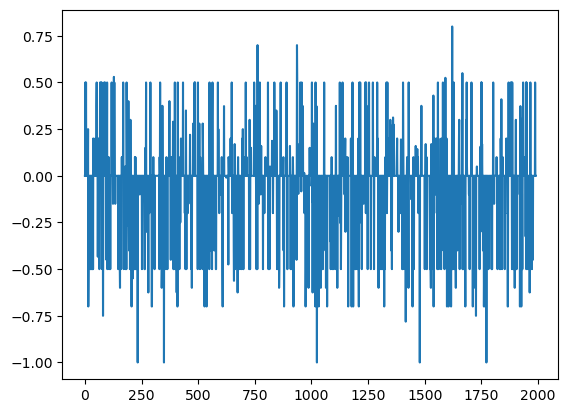

In [318]:
import matplotlib.pyplot as plt

plt.plot(polarity)

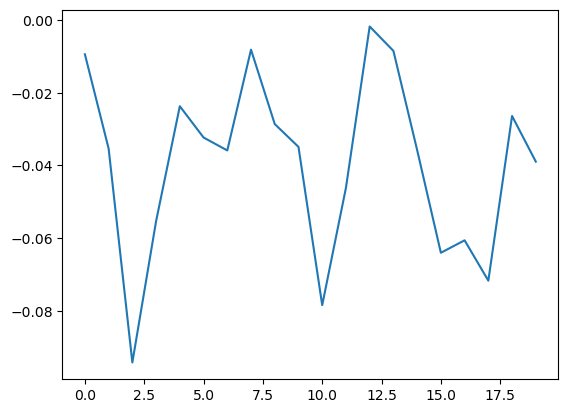

In [319]:
group = lambda polarity, size : [polarity[i:i+size] for i in range(0, len(polarity), size)]

polarity_par_paquet = group(polarity,100)

liste_moyennes = []
for l in polarity_par_paquet :
  liste_moyennes.append(np.mean(l))

plt.plot(liste_moyennes)

In [320]:
len(polarity)

1991

In [321]:
negative_list_text

[['Let us be clear. In 3 finals Liverpool played, 330 minutes of football, overrated Jurgen Klopp has led his team to… https://t.co/zJkBHRNqej',
  'Liverpool campeón!!! Ya estamos en stream para celebrar https://t.co/BeLLsj1Nnw #twitch #LeagueOfLegends #MSI2022',
  'RT @kennethdalglish: The Liverpool fans are special. The way they were treated by authorities was an absolute joke. Nobody should ever be a…',
  'RT @Chunkz: Real Madrid with the best Champions League win ever. They beat PSG, Chelsea, City and Liverpool. Wow.',
  'RT @Volve10Riquelme: 24 remates del Liverpool contra 4 del Real Madrid. 54% de posesion contra el 46%\n\nLos hinchas del Real deben estar tri…',
  'RT @sedatsarac: Dünyanın en iyi ligi denen premier ligin ilk 3ünü eleyip şampiyon olmak. Nereden baksan kral hareket real madrid liverpool…',
  'dps sofre web bullying e fica aí chorando falando q vai processar, tenha paciência viu',
  'RT @BipoIardios: Jkajkja el Liverpool arranco el partido arrodillado contra la disc

In [322]:
nbr_tweets_negatif

325

In [323]:
nbr_tweets_positif

223

In [324]:
nbr_tweets_neutre 

1443

In [325]:
nbr_tweets

1991

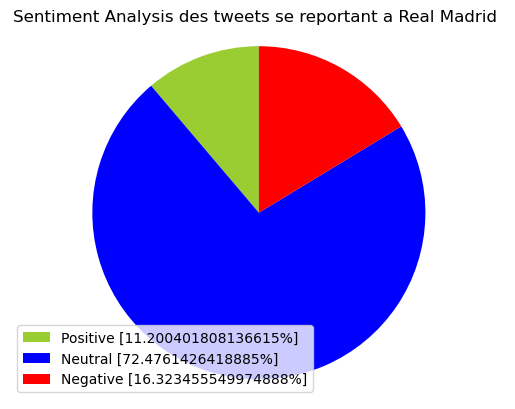

In [326]:
pourc=[(nbr_tweets_positif*100)/nbr_tweets,((nbr_tweets_neutre*100)/nbr_tweets),((nbr_tweets_negatif *100)/nbr_tweets)]
labels = ['Positive ['+str(pourc[0])+'%]' , 'Neutral ['+str(pourc[1])+'%]','Negative ['+str(pourc[2])+'%]']

sizes = [((nbr_tweets_positif*100)/nbr_tweets), ((nbr_tweets_neutre*100)/nbr_tweets), ((nbr_tweets_negatif *100)/nbr_tweets) ]
colors = ['yellowgreen','blue','red']
patches, texts = plt.pie(sizes,colors=colors, startangle=90)
plt.style.use('default')
plt.legend(labels)
plt.title('Sentiment Analysis des tweets se reportant a Real Madrid ')
plt.axis('equal')
plt.show()